# 計算機程式 - 期末報告



# **組員名單：**

105208088 統計四 白崇佑

105208046 經濟四 徐英睿



# **專案分工：**

白崇佑：資料彙整與蒐集 ， 程式撰寫 ， 報告編輯

徐英睿：比較模型好壞並給予調整參數建議 ， 修復BUG



# **問題發想：**

對於GAN這個技術能把美少女畫的多漂亮非常有興趣 

秉持著自己的老婆自己做這個想法，萌生了透過此次專案實作的念頭。



# **流程介紹：**

1.訓練用圖片蒐集來源為 https://reurl.cc/9ExgyO
，裡頭的圖片皆生成自https://crypko.ai/#/
這個網站。合計共有71314張二次元美少女的圖片

2.合計訓練了3組MODEL，分別使用DCGAN調參數訓練了兩組，及使用LSGAN訓練了一組


3.開發上採用pytorch而沒有使用tensorflow，主要是在尋找開源資料時很多都是用pytorch去實作GAN，也想多一些不一樣的嘗試


4.最初提案有打算實作conditional GAN 把文字參數轉成圖片特徵，但實作上遇到一些困難而沒能成功。最後只有把DCGAN訓練出來的MODEL拿去隨機生成一組圖片








# 從網站上將圖片資源匯入到google drive工作目錄中

In [0]:
from google.colab import drive
drive.mount('/content/drive')
workspace_dir = './drive/My Drive/aniface_GAN'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


在匯入圖片檔的過程中出現過蠻多次bug讓後面的模型讀取不到，colab工作環境有時候會沒能順利讀取到欲匯入的圖檔

In [0]:
import gdown
!gdown --id 1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p --output "{workspace_dir}/crypko_data.zip" 

Downloading...
From: https://drive.google.com/uc?id=1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p
To: /content/drive/My Drive/aniface_GAN/crypko_data.zip
452MB [00:03, 114MB/s]


In [0]:
!unzip -q "{workspace_dir}/crypko_data.zip" -d "{workspace_dir}/" #unzip the file pictures

# Data Preprocessing

使用torchvision這個套件來存取圖片，將cv2讀入的圖片格式從BGR轉成torchvision的RGB格式

input shape resize到(64,64)，並且將其value由0~1 線性轉換到-1 ~ 1

In [0]:
from torch.utils.data import Dataset, DataLoader
import cv2
import os

class FaceDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)
    def __getitem__(self,idx):
        fname = self.fnames[idx]
        img = cv2.imread(fname)
        img = self.BGR2RGB(img) #because "torchvision.utils.save_image" use RGB
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples

    def BGR2RGB(self,img):
        return cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

import glob
import torchvision.transforms as transforms

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # resize the image to (64, 64)
    # linearly map [0, 1] to [-1, 1]
    transform = transforms.Compose(
        [transforms.ToPILImage(),
         transforms.Resize((64, 64)),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3) ] )
    dataset = FaceDataset(fnames, transform)
    return dataset

定義 random seed function 以方便日後模型重建

In [0]:
import random
import torch
import numpy as np

def same_seeds(seed):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)  
    np.random.seed(seed)  
    random.seed(seed)  
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

# 開始建立Model

第一回嘗試使用DCGAN作為訓練模型，參數細節如下

batch_size = 64

z_dim = 100

lr = 1e-4

n_epoch = 10

save_dir = os.path.join(workspace_dir, 'logs')

os.makedirs(save_dir, exist_ok=True)

訓練好的模型會以PTH檔案格式存在Google Drive 預設好的工作目錄中

每一回epoch的訓練過程也會存成圖片檔案紀錄在logs資料夾中

In [0]:
import torch.nn as nn
import torch.nn.functional as F

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    """
    input (N, in_dim)
    output (N, 3, 64, 64)
    """
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()
        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2,
                                   padding=2, output_padding=1, bias=False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU())
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU())
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
            nn.Tanh())
        self.apply(weights_init)
    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2_5(y)
        return y

class Discriminator(nn.Module):
    """
    input (N, 3, 64, 64)
    output (N, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()
        def conv_bn_lrelu(in_dim, out_dim):
            return nn.Sequential(
                nn.Conv2d(in_dim, out_dim, 5, 2, 2),
                nn.BatchNorm2d(out_dim),
                nn.LeakyReLU(0.2))
        self.ls = nn.Sequential(
            nn.Conv2d(in_dim, dim, 5, 2, 2), nn.LeakyReLU(0.2),
            conv_bn_lrelu(dim, dim * 2),
            conv_bn_lrelu(dim * 2, dim * 4),
            conv_bn_lrelu(dim * 4, dim * 8),
            nn.Conv2d(dim * 8, 1, 4),
            nn.Sigmoid())
        self.apply(weights_init)        
    def forward(self, x):
        y = self.ls(x)
        y = y.view(-1)
        return y

設定好parameters

In [0]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision

# hyperparameters 
batch_size = 64
z_dim = 100
lr = 1e-4
n_epoch = 10
save_dir = os.path.join(workspace_dir, 'logs')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss criterion
criterion = nn.BCELoss()

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)

dataset = get_dataset(os.path.join(workspace_dir, 'faces'))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)

開始訓練model，定期儲存圖片以便觀察generator當前的生成效果

epoch設定10次偏少，原因方面一來是因為每回訓練時長非常久，可能1-2個小時左右才會做完，甚至嘗試過程中不時有整個模型跑不動的問題。再者不確定是colab這個工作環境的問題與否，設定更高的epoch參數大概第9或10回就執行不下去了

Epoch [1/10] 955/955 Loss_D: 0.2672 Loss_G: 4.2078 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_001.jpg.


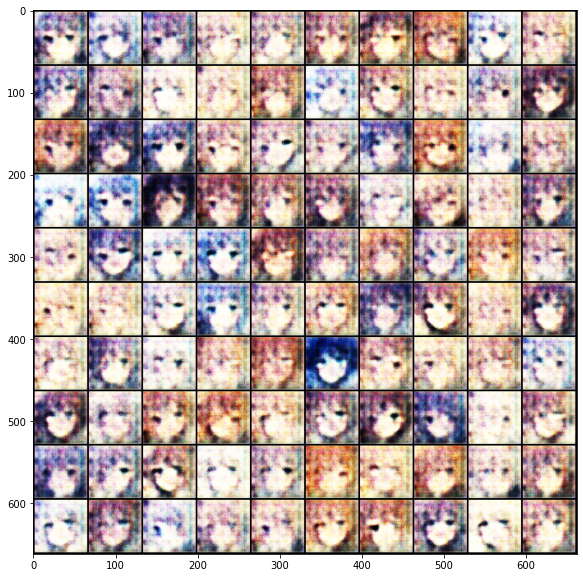

Epoch [2/10] 955/955 Loss_D: 0.3847 Loss_G: 2.5723 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_002.jpg.


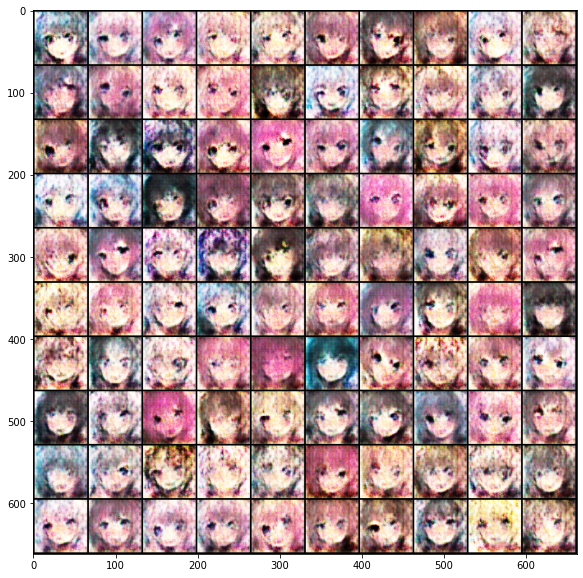

Epoch [3/10] 955/955 Loss_D: 0.1407 Loss_G: 4.1172 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_003.jpg.


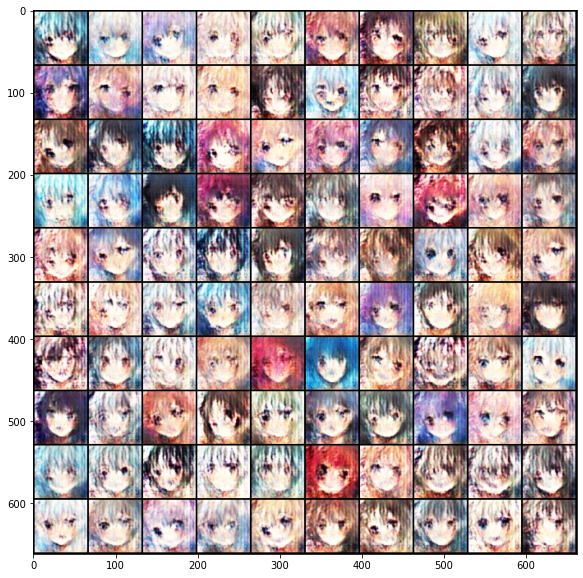

Epoch [4/10] 955/955 Loss_D: 0.1184 Loss_G: 4.7699 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_004.jpg.


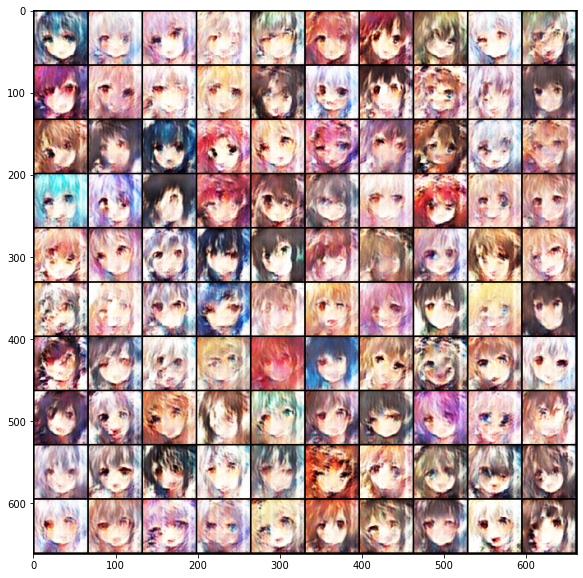

Epoch [5/10] 955/955 Loss_D: 0.1047 Loss_G: 4.4603 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_005.jpg.


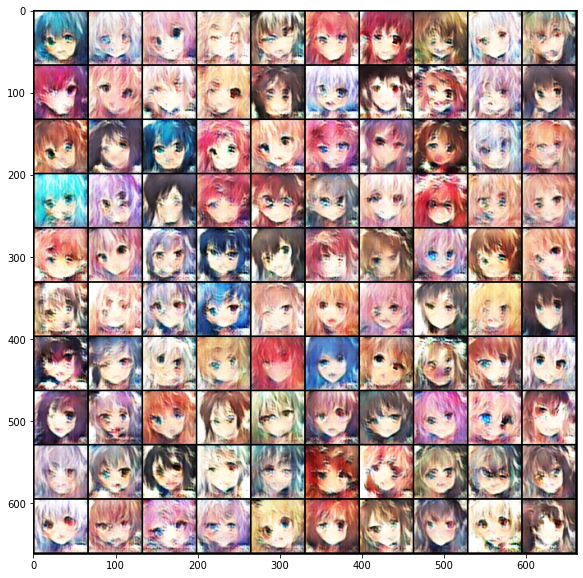

Epoch [6/10] 955/955 Loss_D: 0.2840 Loss_G: 3.6442 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_006.jpg.


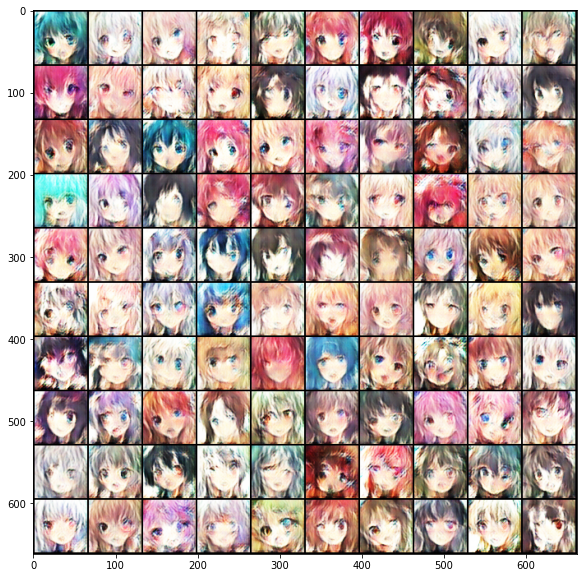

Epoch [7/10] 955/955 Loss_D: 0.4204 Loss_G: 6.4058 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_007.jpg.


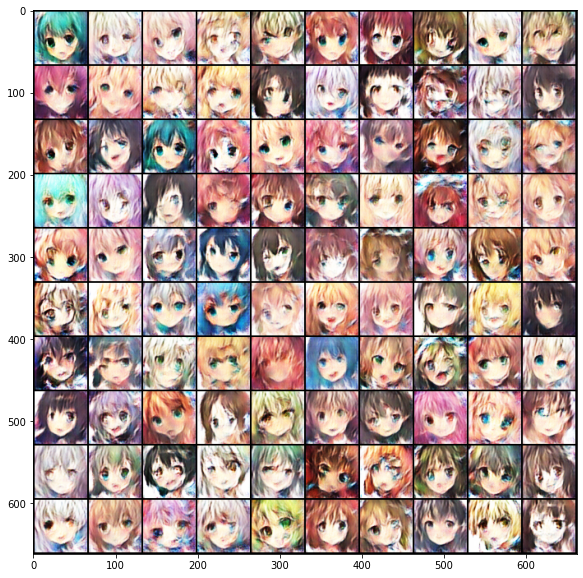

Epoch [8/10] 955/955 Loss_D: 0.2292 Loss_G: 3.3494 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_008.jpg.


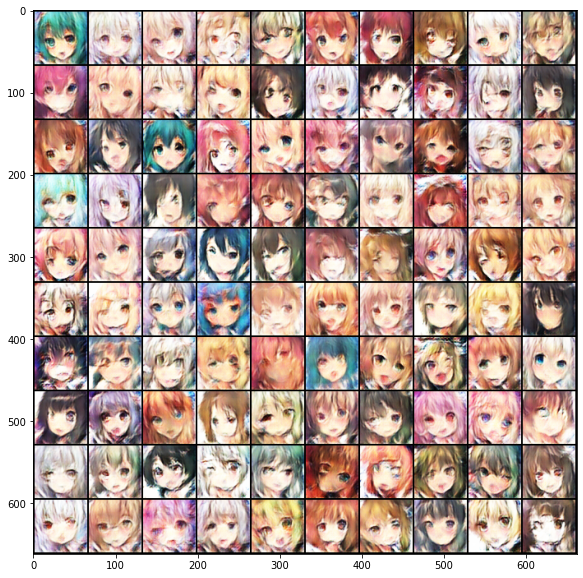

Epoch [9/10] 955/955 Loss_D: 0.2025 Loss_G: 2.0973 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_009.jpg.


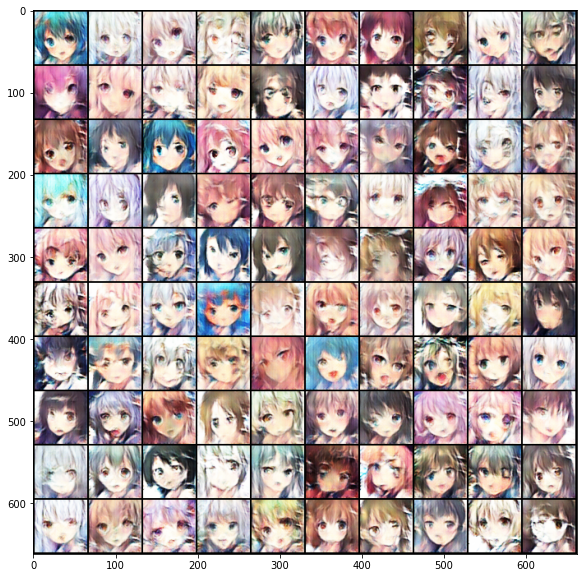

Epoch [10/10] 669/955 Loss_D: 0.1043 Loss_G: 3.7508

In [0]:
# for logging
z_sample = Variable(torch.randn(100, z_dim)).cuda()

for e, epoch in enumerate(range(n_epoch)):
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        """ Train D """
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        # label        
        r_label = torch.ones((bs)).cuda()
        f_label = torch.zeros((bs)).cuda()

        # dis
        r_logit = D(r_imgs.detach())
        f_logit = D(f_imgs.detach())
        
        # compute loss
        r_loss = criterion(r_logit, r_label)
        f_loss = criterion(f_logit, f_label)
        loss_D = (r_loss + f_loss) / 2

        # update model
        D.zero_grad()
        loss_D.backward()
        opt_D.step()

        """ train G """
        # leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)

        # dis
        f_logit = D(f_imgs)
        
        # compute loss
        loss_G = criterion(f_logit, r_label)

        # update model
        G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    # show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    if (e+1) % 5 == 0:
        torch.save(G.state_dict(), os.path.join(workspace_dir, f'dcgan_g.pth'))
        torch.save(D.state_dict(), os.path.join(workspace_dir, f'dcgan_d.pth'))

將我們訓練好的generator拿來隨機生成圖片，就結果來看只能說勉強看得出人物輪廓以及是個女性角色

離能夠當老婆還有很大的距離XDDDDD

In [0]:
import torch
# load pretrained model
G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join(workspace_dir, 'dcgan_g.pth')))
G.eval()
G.cuda()

Generator(
  (l1): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=False)
    (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (l2_5): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()


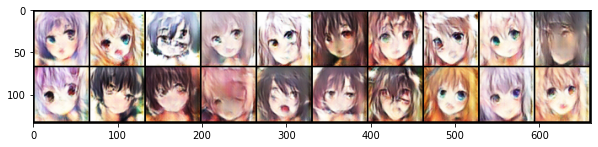

In [0]:
# generate images and save the result
import matplotlib.pyplot as plt 
n_output = 20
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
save_dir = os.path.join(workspace_dir, 'logs')
filename = os.path.join(save_dir, f'result.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)
# show image
grid_img = torchvision.utils.make_grid(imgs_sample.cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

第二次訓練MODEL採用LSGAN，將loss function改成nn.MSELoss，其他參數則跟第一次訓練模型皆一樣，遺憾的是訓練成果非常差，幾乎沒能生成出類似人物的圖片

In [0]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision

# hyperparameters 
batch_size = 64
z_dim = 100
lr = 1e-4
n_epoch = 10
save_dir = os.path.join(workspace_dir, 'logs')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss criterion
criterion = nn.MSELoss()

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)

dataset = get_dataset(os.path.join(workspace_dir, 'faces'))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)

Epoch [1/10] 1115/1115 Loss_D: 0.5000 Loss_G: 1.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_001.jpg.


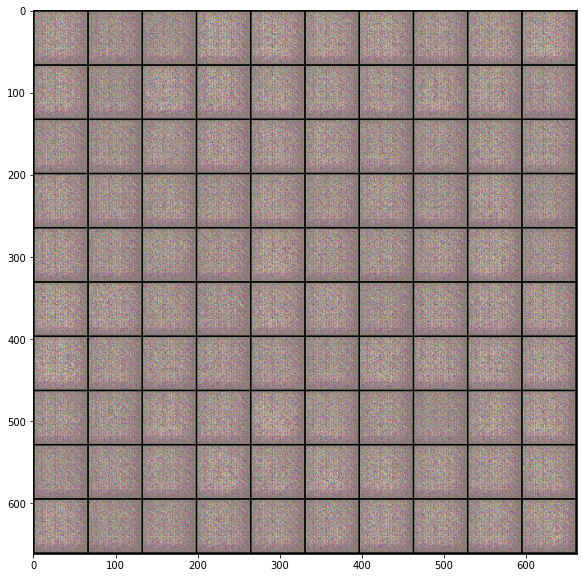

Epoch [2/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_002.jpg.


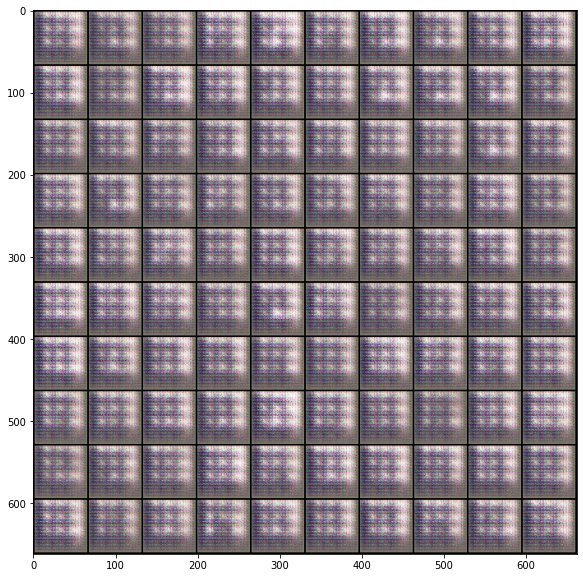

Epoch [3/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_003.jpg.


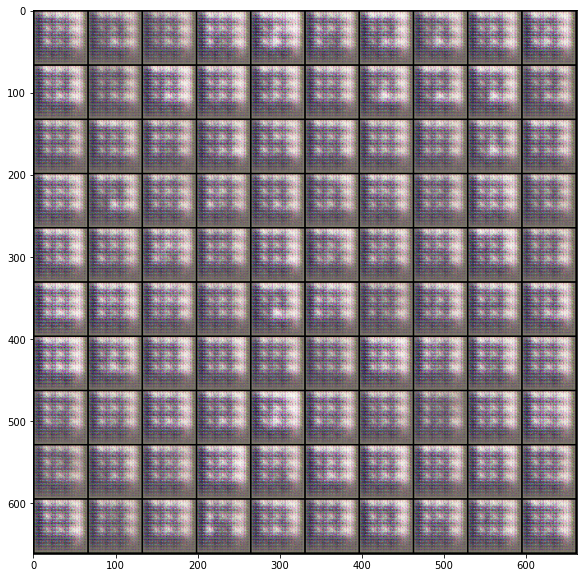

Epoch [4/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_004.jpg.


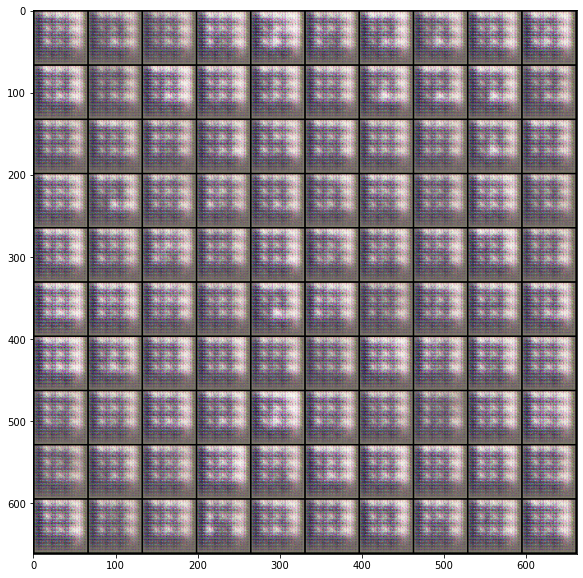

Epoch [5/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_005.jpg.


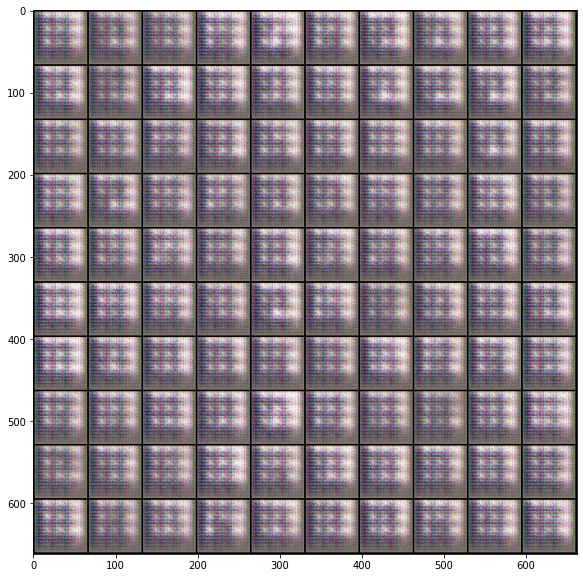

Epoch [6/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_006.jpg.


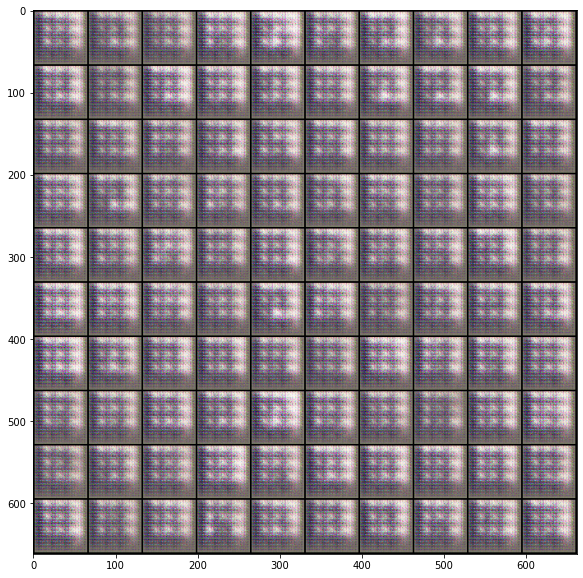

Epoch [7/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_007.jpg.


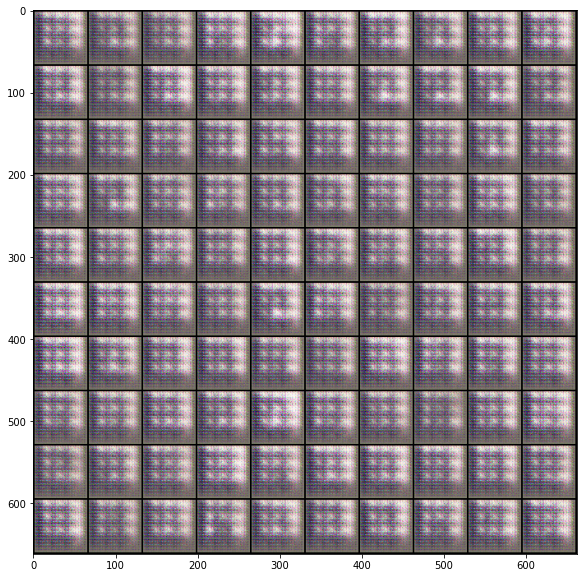

Epoch [8/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_008.jpg.


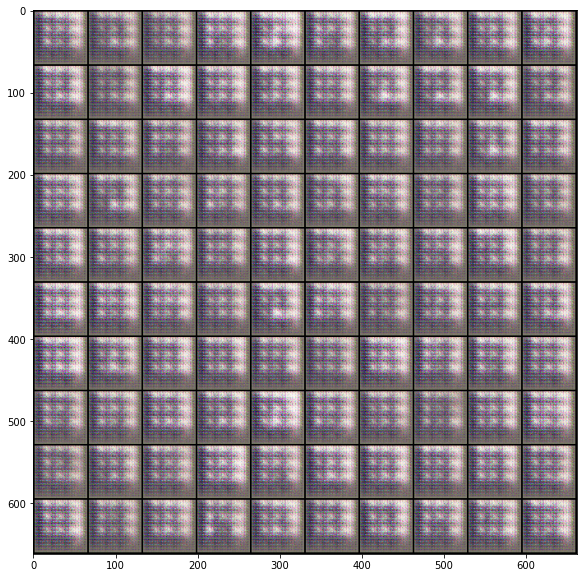

Epoch [9/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_009.jpg.


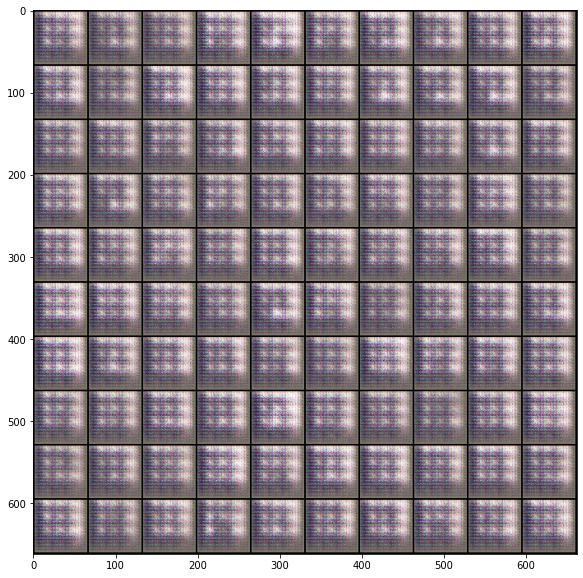

Epoch [10/10] 1115/1115 Loss_D: 0.5000 Loss_G: 0.0000 | Save some samples to ./drive/My Drive/aniface_GAN/logs/Epoch_010.jpg.


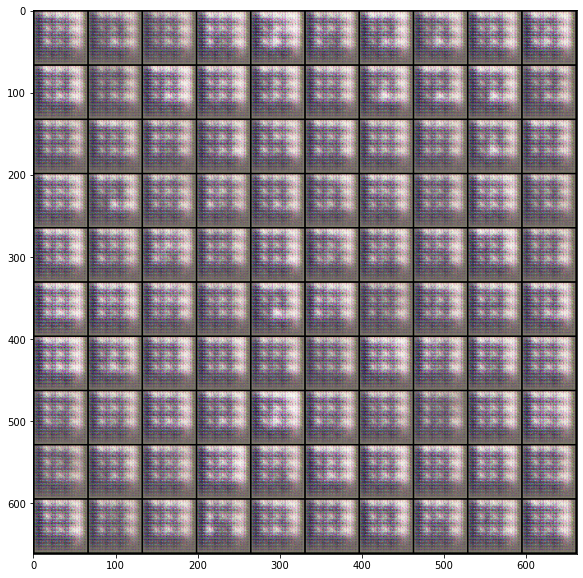

In [0]:
# for logging
import matplotlib.pyplot as plt
z_sample = Variable(torch.randn(100, z_dim)).cuda()

for e, epoch in enumerate(range(n_epoch)):
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        """ Train D """
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        # label        
        r_label = torch.ones((bs)).cuda()
        f_label = torch.zeros((bs)).cuda()

        # dis
        r_logit = D(r_imgs.detach())
        f_logit = D(f_imgs.detach())
        
        # compute loss
        r_loss = criterion(r_logit, r_label)
        f_loss = criterion(f_logit, f_label)
        loss_D = (r_loss + f_loss) / 2

        # update model
        D.zero_grad()
        loss_D.backward()
        opt_D.step()

        """ train G """
        # leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)

        # dis
        f_logit = D(f_imgs)
        
        # compute loss
        loss_G = criterion(f_logit, r_label)

        # update model
        G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    # show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    if (e+1) % 5 == 0:
        torch.save(G.state_dict(), os.path.join(workspace_dir, f'lsgan_g.pth'))
        torch.save(D.state_dict(), os.path.join(workspace_dir, f'lsgan_d.pth'))

第三次模型訓練同樣採用DCGAN，參數方面調整了batch_size(64 -> 128)及learning rate(1e-4 -> 0.0003)

將每次訓練出來的圖片檔存於waifu這個資料夾中。

訓練成像上看起來跟第一回model差異不大。

In [0]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision

# hyperparameters 
batch_size = 128
z_dim = 100
lr = 0.0003
n_epoch = 10
save_dir = os.path.join(workspace_dir, 'waifu')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss criterion
criterion = nn.BCELoss()

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)

dataset = get_dataset(os.path.join(workspace_dir, 'faces'))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=4)

Epoch [1/10] 558/558 Loss_D: 0.1136 Loss_G: 4.4444 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_001.jpg.


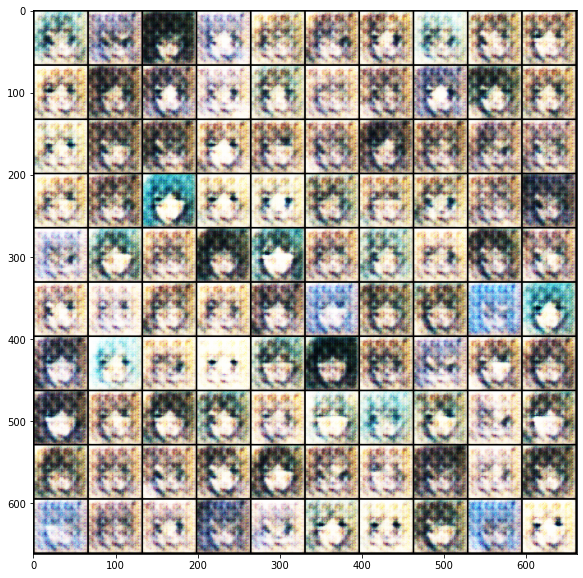

Epoch [2/10] 558/558 Loss_D: 0.1987 Loss_G: 5.1532 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_002.jpg.


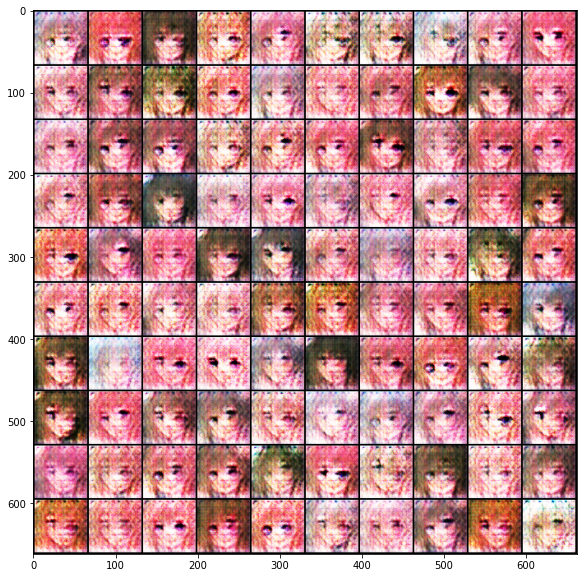

Epoch [3/10] 558/558 Loss_D: 0.7950 Loss_G: 1.7402 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_003.jpg.


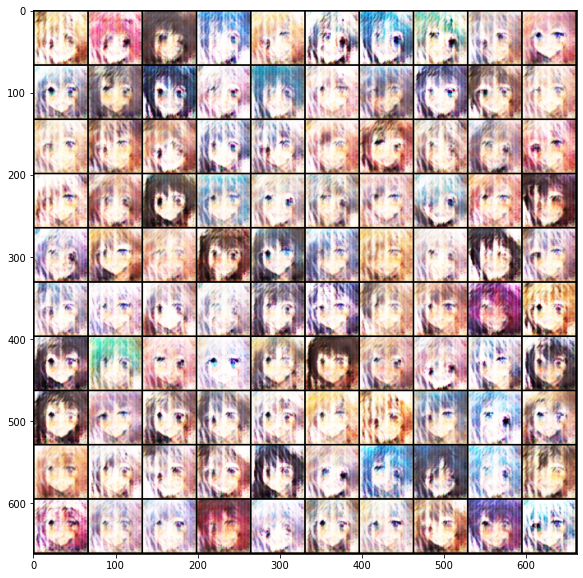

Epoch [4/10] 558/558 Loss_D: 0.3613 Loss_G: 3.8892 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_004.jpg.


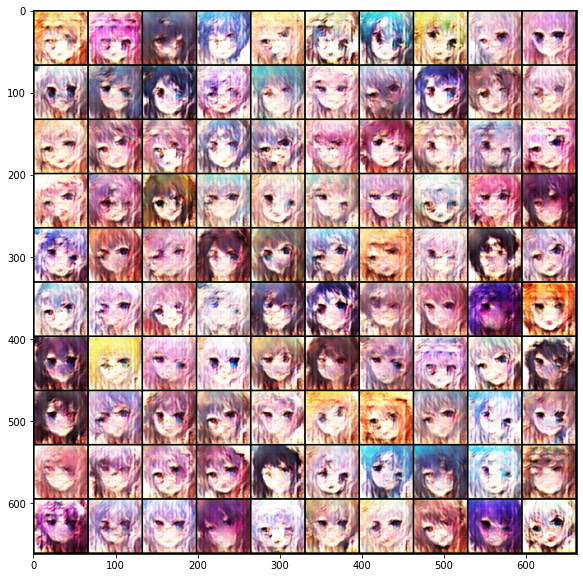

Epoch [5/10] 558/558 Loss_D: 0.3341 Loss_G: 6.0700 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_005.jpg.


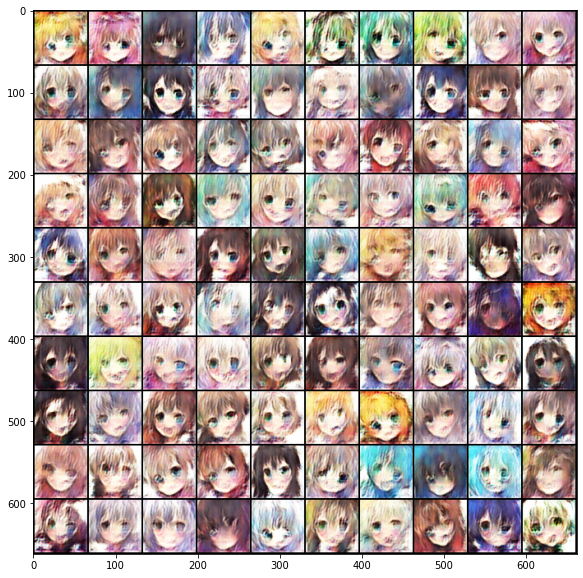

Epoch [6/10] 558/558 Loss_D: 0.2606 Loss_G: 2.8453 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_006.jpg.


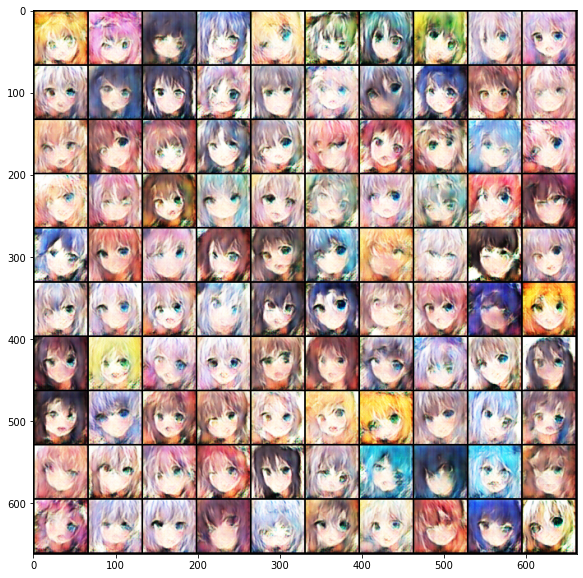

Epoch [7/10] 558/558 Loss_D: 0.3852 Loss_G: 1.7160 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_007.jpg.


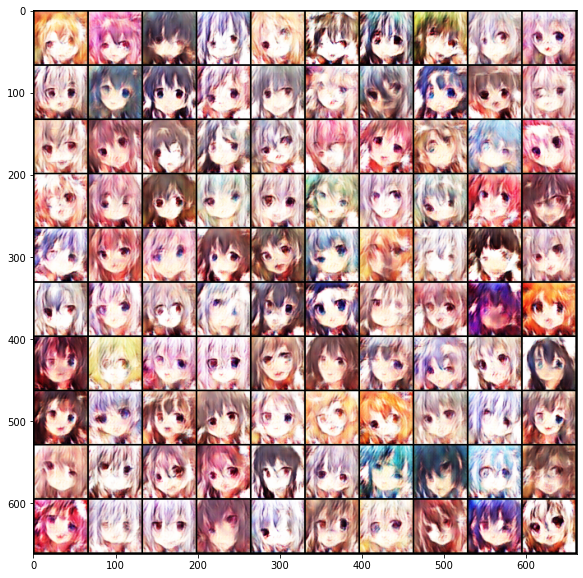

Epoch [8/10] 558/558 Loss_D: 0.3377 Loss_G: 5.0852 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_008.jpg.


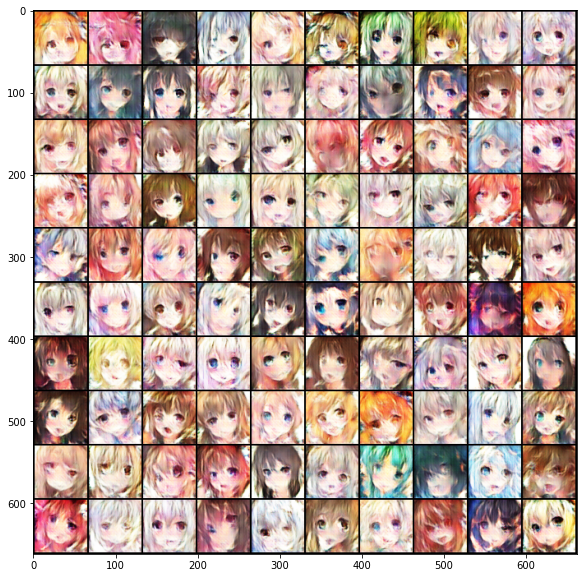

Epoch [9/10] 558/558 Loss_D: 0.3743 Loss_G: 1.7005 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_009.jpg.


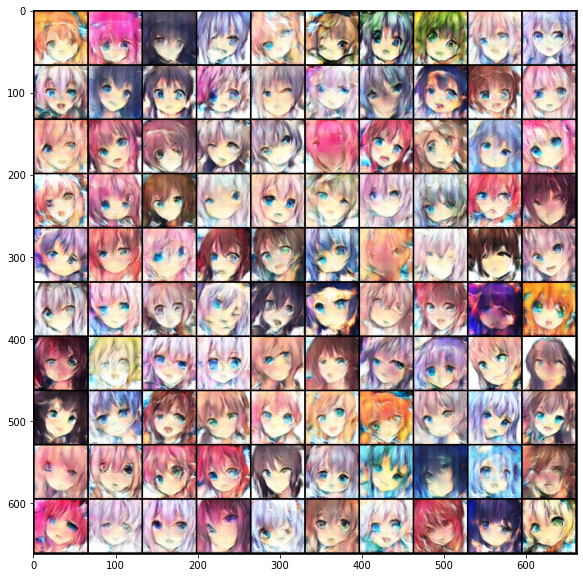

Epoch [10/10] 558/558 Loss_D: 0.2205 Loss_G: 2.4304 | Save some samples to ./drive/My Drive/aniface_GAN/waifu/Epoch_010.jpg.


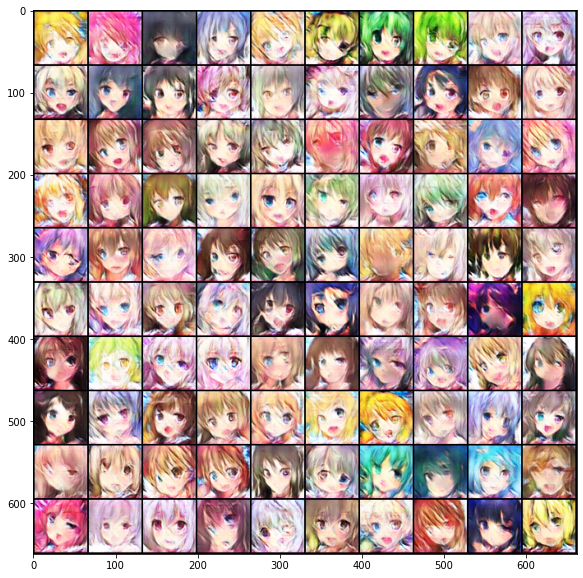

In [0]:
# for logging
import matplotlib.pyplot as plt
z_sample = Variable(torch.randn(100, z_dim)).cuda()

for e, epoch in enumerate(range(n_epoch)):
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        """ Train D """
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        # label        
        r_label = torch.ones((bs)).cuda()
        f_label = torch.zeros((bs)).cuda()

        # dis
        r_logit = D(r_imgs.detach())
        f_logit = D(f_imgs.detach())
        
        # compute loss
        r_loss = criterion(r_logit, r_label)
        f_loss = criterion(f_logit, f_label)
        loss_D = (r_loss + f_loss) / 2

        # update model
        D.zero_grad()
        loss_D.backward()
        opt_D.step()

        """ train G """
        # leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)

        # dis
        f_logit = D(f_imgs)
        
        # compute loss
        loss_G = criterion(f_logit, r_label)

        # update model
        G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    # show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    if (e+1) % 5 == 0:
        torch.save(G.state_dict(), os.path.join(workspace_dir, f'dcgan_g_v2.pth'))
        torch.save(D.state_dict(), os.path.join(workspace_dir, f'dcgan_d_v2.pth'))

# Conclusion

此次實作GAN專案感受到沒有好的顯示卡似乎很難從事相關的實驗工作。最一開始是在本機端用筆電的GTX1050 2g 去跑，電腦過熱差點燒起來不提，訓練速度遠慢於使用colab開gpu去加速。即使如此還是有點慢，若要嘗試上萬次的epoch可能需要有工作站等級的設備才能如期執行

有想要嘗試更多的loss function諸如 nn.SmoothL1Loss，nn.CrossEntropyLoss和nn.NLLLoss。但執行過程中噴出不少bug，本人也沒能順利解決只好遺憾作罷。

# 參考資料：
https://crypko.ai/#/

https://pytorch.org/tutorials/

https://github.com/Natsu6767/DCGAN-PyTorch

https://github.com/eriklindernoren/PyTorch-GAN/blob/master/implementations/wgan/wgan.py

https://github.com/eriklindernoren/PyTorch-GAN/blob/master/implementations/lsgan/lsgan.py

https://github.com/ANIME305/Anime-GAN-tensorflow

https://github.com/mchong6/Draw-Anime-GAN

https://github.com/pavitrakumar78/Anime-Face-GAN-Keras

https://www.youtube.com/watch?v=DQNNMiAP5lw&list=PLJV_el3uVTsMq6JEFPW35BCiOQTsoqwNw

https://speech.ee.ntu.edu.tw/~tlkagk/index.html



# 專案提問：

## 1.請充分說明DCGAN

## 2.請充分說明LSGAN

## 3.請簡述 GAN 系列模型的訓練方式 

# 專案回答：

## 1. DCGAN全名為Deep Convolutional Generative Adversarial Networks。

## 模型的大致架構如下：

## (1) generator(生成器) and discriminator(判別器)均不採用  pooling layers，而是採用convolution layers；其中discriminator採用Conv2D，而generator採用DeConv2D。

## (2) 在generator和discriminator上均使用 Batch Normalization

## (3) 在生成器除輸出層外的所有層上使用 relu activation function，而輸出層使用 Tanh activation function

## (4) convolution layers 之後不使用fully connected layers

## (5) 判別器在最後一個convolution layers之後也不用 Global Pooling，而是直接 Flatten

## 我在程式撰寫上大致照著這個架構走去建模。DCGAN算是奠定了現代GAN設計上的基礎架構，實作成果就印出的結果來看還不錯。


## 2. LSGAN全名為Least Squares Generative Adversarial Networks。其核心想法就是把常規GAN discriminator使用的sigmoid cross entropy loss function替換成 least squares loss function。如此一來可以使discriminator更加平滑和非飽和，避免學習過程中梯度消失的問題。

## 實作過程中我是直接沿用DCGAN的架構，只有抽換掉loss function去建立lsgan。訓練的成果並不是很理想，連像人形的圖片都沒有。預期可能是我實作流程有誤，或是lsgan無法架立在dcgan上的基礎運行。

## 3. GAN 模型訓練方法上屬於非監督式學習，最值觀的就是建立Discriminator(D)跟Generator(G)兩個神經網路。D以真實圖片作為訓練資料，日後便可根據G生成的圖片與訓練資料相不相似給分，越相似越高分，反之則低分。G則是一開始隨機給雜訊來生成，透過D的反饋不斷調整生成的圖片以最終騙過D為目的。

## 可以把Generator + Discriminator看成是一個大的Neural Network，我們只更新G的weight, 而D的weight則要保持以維持一致性。結論就是更新生成器的參數讓Discriminator接近真實的結果。



